Below example was made by R.

 - https://github.com/jongchul/genomic-R 

 - I just make the example again using jupyter notebook. 

In [1]:
library(GEOquery)
library(affy)
library(dendextend)
library(biomaRt)
library(limma)

Loading required package: Biobase
Loading required package: BiocGenerics
Loading required package: parallel

Attaching package: ‘BiocGenerics’

The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB

The following objects are masked from ‘package:stats’:

    IQR, mad, xtabs

The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, as.vector, cbind, colnames,
    do.call, duplicated, eval, evalq, Filter, Find, get, grep, grepl,
    intersect, is.unsorted, lapply, lengths, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, tapply,
    union, unique, unlist, unsplit

Welcome to Bioconductor

    Vignettes contain introductory material; view with
    'browseVignettes()'. To c

In [2]:
# Below code should be executed to download files.

#getGEOSuppFiles("GSE59880")
#untar("GSE59880/GSE59880_RAW.tar", exdir = "GSE59880/CEL")

list.files("GSE59880")

#list.files("GSE59880/CEL")

[1] "CEL"              "filelist.txt"     "GSE59880_RAW.tar"

I use 'tar' and 'gzip' commands to uncompress files manually instead of '/bin/gtar' command.

In [3]:
celfiles <- list.files("GSE59880/CEL")
celfiles <- unlist(celfiles)

In [4]:
rawData <- ReadAffy(filenames = celfiles,celfile.path='/home/vagrant/maybegit/tensorflow-exercise/R/GSE59880/CEL/')

'/home/vagrant/maybegit/tensorflow-exercise/R/GSE59880/CEL/' is my directory path. 

[1] 1354896      30

,GSM1448899_o9.CEL,GSM1448900_o15.CEL,GSM1448901_o2.CEL,GSM1448902_o8.CEL,GSM1448903_o7.CEL,GSM1448904_o5.CEL,GSM1448905_o11.CEL,GSM1448906_o6.CEL,GSM1448907_o14.CEL,GSM1448908_o1.CEL,GSM1448909_o4.CEL,GSM1448910_o13.CEL,GSM1448911_o12.CEL,GSM1448912_o3.CEL,GSM1448913_o10.CEL,GSM1448914_y14.CEL,GSM1448915_y13.CEL,GSM1448916_y3.CEL,GSM1448917_y2.CEL,GSM1448918_y12.CEL,GSM1448919_y9.CEL,GSM1448920_y6.CEL,GSM1448921_y5.CEL,GSM1448922_y1.CEL,GSM1448923_y15.CEL,GSM1448924_y8.CEL,GSM1448925_y4.CEL,GSM1448926_y11.CEL,GSM1448927_y7.CEL,GSM1448928_y10.CEL
1,133,82,89,128,177,181,168,199,151,297,181,182,176,117,179,105,86,122,101,104,124,89,122,87,128,100,173,84,111,95
2,9521,6111,7469,9238,12941,10435,11645,11837,10463,13348,11302,12461,10522,11704,11896,7948,11625,12266,10941,12106,11824,12976,12256,11975,12898,15954,10835,13932,11744,11176
3,189,118,149,158,237,209,268,293,241,328,222,272,278,249,180,148,142,118,145,144,126,99,116,130,148,152,162,109,128,131
4,9413,7508,7865,9594,13234,11041,12061,11910,10667,13348,11271,12414,11195,12044,12451,8365,12205,12865,11773,12694,12189,13710,12999,13757,12484,16190,10845,14765,12765,11783
5,72,74,78,104,106,103,146,136,130,131,102,108,111,94,96,89,98,80,83,108,102,84,86,92,102,90,80,105,100,80
6,154,93,78,95,126,140,173,166,156,223,161,127,145,144,126,74,91,85,89,78,99,74,104,81,86,77,120,78,77,85
7,9545,6393,7694,9108,13347,10857,11830,12009,10544,13120,11418,12395,10582,12278,12575,8194,11801,12374,11431,12345,12125,12866,12060,12251,12763,15552,10754,14030,11846,11362
8,199,105,112,147,195,218,220,235,201,282,202,178,204,208,183,131,104,136,122,103,100,108,93,137,117,147,128,123,109,109
9,9221,6547,7371,8919,12795,10912,11787,11798,10473,13134,11034,12650,10612,11896,12717,7807,11545,12453,11034,12168,11905,13037,12148,11846,12423,15632,10705,13965,11231,10725
10,206,102,99,122,180,171,231,217,215,290,181,170,190,185,183,131,105,121,96,88,107,89,106,145,124,120,149,125,121,91


[1] 0

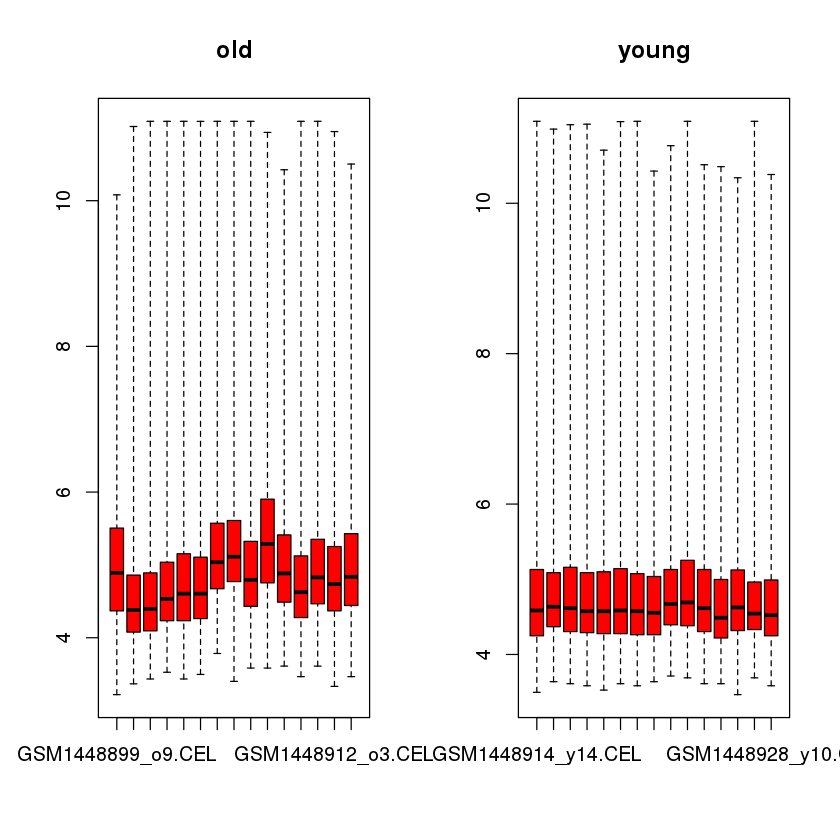

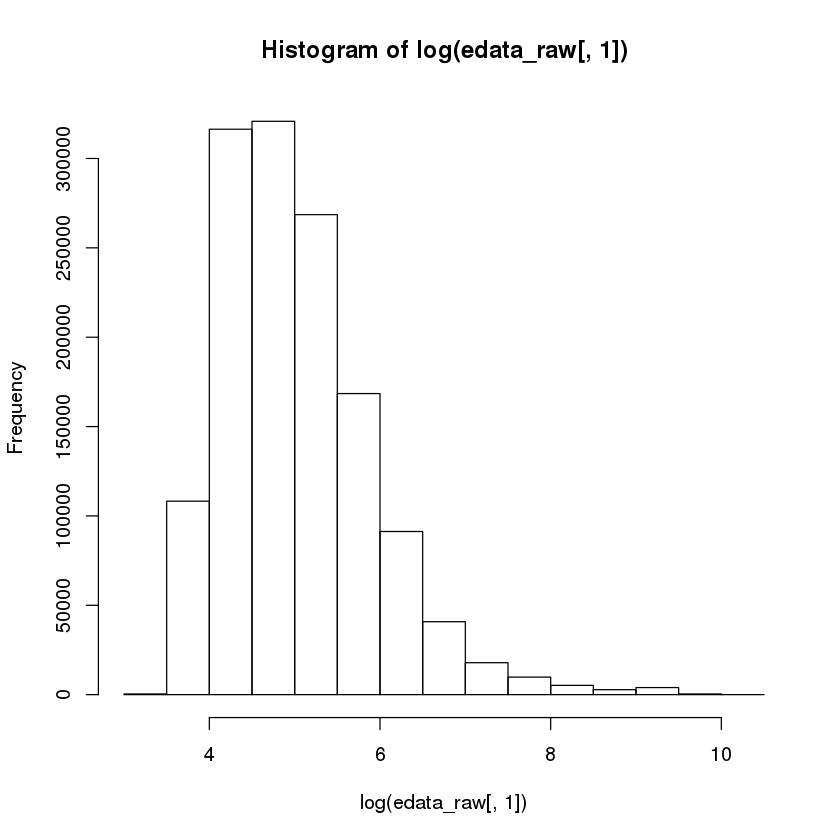

In [5]:
edata_raw <- exprs(rawData)

dim(edata_raw)

edata_raw[1:10,]

sum(is.na(edata_raw))

par(mfrow=c(1,2))

boxplot(log(edata_raw[,1:15]), main="old", col=2,range=0 )

boxplot(log(edata_raw[,16:30]), main="young", col=2,range=0 )

par(mfrow=c(1,1))

hist(log(edata_raw[,1]))


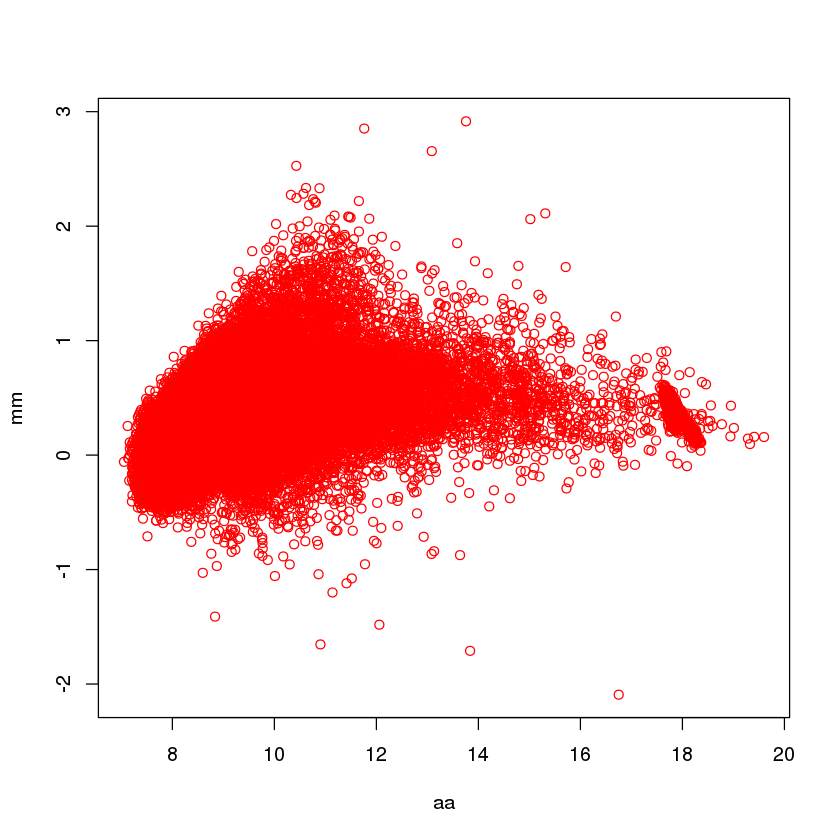

In [6]:
mm = log(edata_raw[0:50000,1]+1) - log(edata_raw[0:50000,2]+1)
aa = log(edata_raw[0:50000,1]+1) + log(edata_raw[0:50000,2]+1)
plot(aa,mm,col=2)

In [7]:
normData <- rma(rawData)
normData

dim(normData)

Warning message:
: replacing previous import by ‘utils::tail’ when loading ‘hgu133plus2cdf’Warning message:
: replacing previous import by ‘utils::head’ when loading ‘hgu133plus2cdf’


Background correcting
Normalizing
Calculating Expression


ExpressionSet (storageMode: lockedEnvironment)
assayData: 54675 features, 30 samples 
  element names: exprs 
protocolData
  sampleNames: GSM1448899_o9.CEL GSM1448900_o15.CEL ...
    GSM1448928_y10.CEL (30 total)
  varLabels: ScanDate
  varMetadata: labelDescription
phenoData
  sampleNames: GSM1448899_o9.CEL GSM1448900_o15.CEL ...
    GSM1448928_y10.CEL (30 total)
  varLabels: sample
  varMetadata: labelDescription
featureData: none
experimentData: use 'experimentData(object)'
Annotation: hgu133plus2 

Features  Samples 
   54675       30

,GSM1448899_o9.CEL,GSM1448900_o15.CEL,GSM1448901_o2.CEL,GSM1448902_o8.CEL,GSM1448903_o7.CEL,GSM1448904_o5.CEL,GSM1448905_o11.CEL,GSM1448906_o6.CEL,GSM1448907_o14.CEL,GSM1448908_o1.CEL,GSM1448909_o4.CEL,GSM1448910_o13.CEL,GSM1448911_o12.CEL,GSM1448912_o3.CEL,GSM1448913_o10.CEL,GSM1448914_y14.CEL,GSM1448915_y13.CEL,GSM1448916_y3.CEL,GSM1448917_y2.CEL,GSM1448918_y12.CEL,GSM1448919_y9.CEL,GSM1448920_y6.CEL,GSM1448921_y5.CEL,GSM1448922_y1.CEL,GSM1448923_y15.CEL,GSM1448924_y8.CEL,GSM1448925_y4.CEL,GSM1448926_y11.CEL,GSM1448927_y7.CEL,GSM1448928_y10.CEL
1007_s_at,7.875508,8.198191,8.396702,8.276055,8.413298,8.147301,8.050174,8.356763,8.145527,7.874097,8.369380,8.091557,8.532048,8.106704,8.548438,7.968159,7.838629,7.820138,7.483329,7.864072,7.920108,7.687112,8.008396,7.922350,7.614268,8.017033,7.840298,8.189962,7.743020,7.817590
1053_at,5.987834,5.795781,6.167283,6.018262,6.247654,5.774419,6.197051,6.314568,6.060218,5.596467,5.852481,6.230639,5.962514,6.119486,6.086958,5.898147,5.978072,6.142546,5.949754,6.027613,5.862391,5.686912,5.782141,5.886802,5.755121,5.708405,5.995029,5.977380,5.524940,5.738622
117_at,4.624441,4.821709,4.602531,4.663185,4.343668,4.578035,4.343419,4.525314,4.465046,4.662688,4.662464,4.542477,4.508683,4.537797,4.744469,4.553845,4.829061,4.707318,4.845280,4.775071,4.823241,4.653771,4.606054,4.739874,4.916243,4.854989,4.599597,4.826491,4.467357,4.614699
121_at,8.077270,8.280966,7.927748,7.898542,7.753320,8.103925,7.693411,7.471496,8.231235,8.304543,8.272249,8.047825,8.103280,8.010479,7.858428,8.111870,8.223451,7.707556,7.341969,7.413821,7.409918,8.265000,8.180099,8.171447,7.620127,8.143749,7.488775,8.346130,7.568558,7.573623
1255_g_at,3.375005,3.054272,3.094827,3.126682,2.932595,3.104291,3.051101,3.041381,3.190205,3.367877,3.231551,3.278679,2.975104,2.925563,3.073587,3.104026,3.120742,2.952963,3.233416,3.120287,2.976859,3.379284,3.199246,3.223816,2.906558,3.221499,3.066788,3.241629,3.144762,2.960716
1294_at,5.989669,5.920123,5.974775,5.769933,6.107131,5.784597,5.508413,5.562288,5.846761,5.825436,5.985294,5.827329,5.960877,5.848867,6.078040,5.899368,5.957957,5.781225,5.729535,5.627618,5.632943,6.065316,5.835103,6.114564,5.768448,5.950213,5.677339,6.174083,5.469858,5.752867


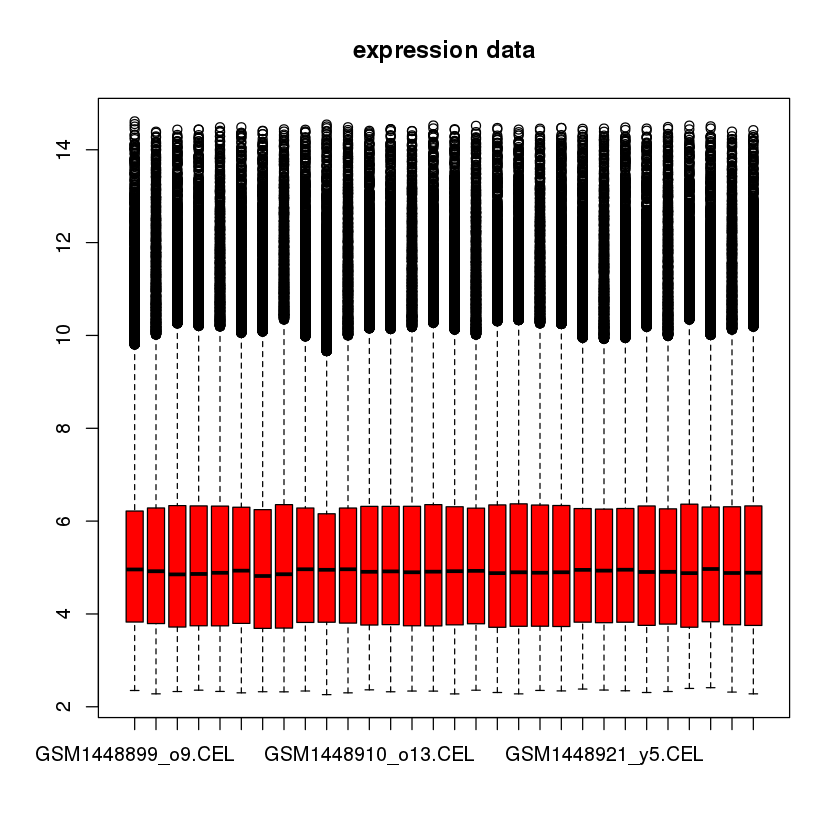

In [8]:
head(exprs(normData))

edata <- exprs(normData)

boxplot(edata[,1:30],main="expression data",col=2)

In [10]:
geoMat <- getGEO("GSE59880",destdir = "/home/vagrant/maybegit/tensorflow-exercise/R/GSE59880")

ftp://ftp.ncbi.nlm.nih.gov/geo/series/GSE59nnn/GSE59880/matrix/
Found 1 file(s)
GSE59880_series_matrix.txt.gz
File stored at: 
/home/vagrant/maybegit/tensorflow-exercise/R/GSE59880/GPL570.soft


In [12]:
pD.all <- pData(geoMat[[1]])

head(pD.all)
names(pD.all)

##pD <- pD.all[, c("title", "geo_accession", "characteristics_ch1.1","characteristics_ch1.2","characteristics_ch1.3","characteristics_ch1.4","platform_id"  )]


pD <- pD.all[, c("title", "geo_accession", "characteristics_ch1.1","characteristics_ch1.2")]

names(pD)[c(3,4)] <- c("age", "fitness")
## head(pD)

##pD$age
pD$age <- sub("^age: ","", pD$age)
##pD$age

##pD$fitness 
pD$fitness <- sub("^aerobic fitness: ", "", pD$fitness)
##pD$fitness

changeName <- function(x) {

    print("function starts.... object length is")
    print(length(x))

    for (i in 1:length(x)) {

      x[i] <- substr(x[i], start=1, stop=10) 

      print(x[i])
    }

  return(x)

}

sampleNames(normData) <- changeName(sampleNames(normData))

sampleNames(normData)

,title,geo_accession,status,submission_date,last_update_date,type,channel_count,source_name_ch1,organism_ch1,characteristics_ch1,characteristics_ch1.1,characteristics_ch1.2,characteristics_ch1.3,characteristics_ch1.4,treatment_protocol_ch1,growth_protocol_ch1,molecule_ch1,extract_protocol_ch1,label_ch1,label_protocol_ch1,taxid_ch1,hyb_protocol,scan_protocol,description,data_processing,platform_id,contact_name,contact_email,contact_institute,contact_address,contact_city,contact_zip/postal_code,contact_country,supplementary_file,data_row_count
GSM1448899,o9,GSM1448899,Public on Aug 05 2015,Jul 29 2014,Aug 06 2015,RNA,1,resting skeletal muscle,Homo sapiens,group: old,age: 63,aerobic fitness: 3.50,gender: male,tissue: skeletal muscle,Subjects were physiologically assessed at baseline,Not applicable,total RNA,TRIzol,biotin,Affymetrix Standard protocol.,9606,Affymetrix Standard protocol.,Affymetrix Standard protocol.,no additional information,The data was analyzed with the affy package from Bioconductor using the RMA algorithm.,GPL570,"Jamie,,Timmons",jamie.timmons@xrgenomics.com,XRGenomics,"31-35,Kirby street",London,EC1N 8TE,United Kingdom,ftp://ftp.ncbi.nlm.nih.gov/pub/geo/DATA/supplementary/samples/GSM1448nnn/GSM1448899/GSM1448899_o9.CEL.gz,54675
GSM1448900,o15,GSM1448900,Public on Aug 05 2015,Jul 29 2014,Aug 06 2015,RNA,1,resting skeletal muscle,Homo sapiens,group: old,age: 77,aerobic fitness: 2.74,gender: male,tissue: skeletal muscle,Subjects were physiologically assessed at baseline,Not applicable,total RNA,TRIzol,biotin,Affymetrix Standard protocol.,9606,Affymetrix Standard protocol.,Affymetrix Standard protocol.,no additional information,The data was analyzed with the affy package from Bioconductor using the RMA algorithm.,GPL570,"Jamie,,Timmons",jamie.timmons@xrgenomics.com,XRGenomics,"31-35,Kirby street",London,EC1N 8TE,United Kingdom,ftp://ftp.ncbi.nlm.nih.gov/pub/geo/DATA/supplementary/samples/GSM1448nnn/GSM1448900/GSM1448900_o15.CEL.gz,54675
GSM1448901,o2,GSM1448901,Public on Aug 05 2015,Jul 29 2014,Aug 06 2015,RNA,1,resting skeletal muscle,Homo sapiens,group: old,age: 59,aerobic fitness: 2.63,gender: male,tissue: skeletal muscle,Subjects were physiologically assessed at baseline,Not applicable,total RNA,TRIzol,biotin,Affymetrix Standard protocol.,9606,Affymetrix Standard protocol.,Affymetrix Standard protocol.,no additional information,The data was analyzed with the affy package from Bioconductor using the RMA algorithm.,GPL570,"Jamie,,Timmons",jamie.timmons@xrgenomics.com,XRGenomics,"31-35,Kirby street",London,EC1N 8TE,United Kingdom,ftp://ftp.ncbi.nlm.nih.gov/pub/geo/DATA/supplementary/samples/GSM1448nnn/GSM1448901/GSM1448901_o2.CEL.gz,54675
GSM1448902,o8,GSM1448902,Public on Aug 05 2015,Jul 29 2014,Aug 06 2015,RNA,1,resting skeletal muscle,Homo sapiens,group: old,age: 63,aerobic fitness: 2.42,gender: male,tissue: skeletal muscle,Subjects were physiologically assessed at baseline,Not applicable,total RNA,TRIzol,biotin,Affymetrix Standard protocol.,9606,Affymetrix Standard protocol.,Affymetrix Standard protocol.,no additional information,The data was analyzed with the affy package from Bioconductor using the RMA algorithm.,GPL570,"Jamie,,Timmons",jamie.timmons@xrgenomics.com,XRGenomics,"31-35,Kirby street",London,EC1N 8TE,United Kingdom,ftp://ftp.ncbi.nlm.nih.gov/pub/geo/DATA/supplementary/samples/GSM1448nnn/GSM1448902/GSM1448902_o8.CEL.gz,54675
GSM1448903,o7,GSM1448903,Public on Aug 05 2015,Jul 29 2014,Aug 06 2015,RNA,1,resting skeletal muscle,Homo sapiens,group: old,age: 63,aerobic fitness: 2.32,gender: male,tissue: skeletal muscle,Subjects were physiologically assessed at baseline,Not applicable,total RNA,TRIzol,biotin,Affymetrix Standard protocol.,9606,Affymetrix Standard protocol.,Affymetrix Standard protocol.,no additional information,The data was analyzed with the affy package from Bioconductor using the RMA algorithm.,GPL570,"Jamie,,Timmons",jamie.timmons@xrgenomics.com,XRGenomics,"31-35,Kirby street",London,

[1] "title"                   "geo_accession"          
 [3] "status"                  "submission_date"        
 [5] "last_update_date"        "type"                   
 [7] "channel_count"           "source_name_ch1"        
 [9] "organism_ch1"            "characteristics_ch1"    
[11] "characteristics_ch1.1"   "characteristics_ch1.2"  
[13] "characteristics_ch1.3"   "characteristics_ch1.4"  
[15] "treatment_protocol_ch1"  "growth_protocol_ch1"    
[17] "molecule_ch1"            "extract_protocol_ch1"   
[19] "label_ch1"               "label_protocol_ch1"     
[21] "taxid_ch1"               "hyb_protocol"           
[23] "scan_protocol"           "description"            
[25] "data_processing"         "platform_id"            
[27] "contact_name"            "contact_email"          
[29] "contact_institute"       "contact_address"        
[31] "contact_city"            "contact_zip/postal_code"
[33] "contact_country"         "supplementary_file"     
[35] "data_row_count"

[1] "function starts.... object length is"
[1] 30
[1] "GSM1448899"
[1] "GSM1448900"
[1] "GSM1448901"
[1] "GSM1448902"
[1] "GSM1448903"
[1] "GSM1448904"
[1] "GSM1448905"
[1] "GSM1448906"
[1] "GSM1448907"
[1] "GSM1448908"
[1] "GSM1448909"
[1] "GSM1448910"
[1] "GSM1448911"
[1] "GSM1448912"
[1] "GSM1448913"
[1] "GSM1448914"
[1] "GSM1448915"
[1] "GSM1448916"
[1] "GSM1448917"
[1] "GSM1448918"
[1] "GSM1448919"
[1] "GSM1448920"
[1] "GSM1448921"
[1] "GSM1448922"
[1] "GSM1448923"
[1] "GSM1448924"
[1] "GSM1448925"
[1] "GSM1448926"
[1] "GSM1448927"
[1] "GSM1448928"


[1] "GSM1448899" "GSM1448900" "GSM1448901" "GSM1448902" "GSM1448903"
 [6] "GSM1448904" "GSM1448905" "GSM1448906" "GSM1448907" "GSM1448908"
[11] "GSM1448909" "GSM1448910" "GSM1448911" "GSM1448912" "GSM1448913"
[16] "GSM1448914" "GSM1448915" "GSM1448916" "GSM1448917" "GSM1448918"
[21] "GSM1448919" "GSM1448920" "GSM1448921" "GSM1448922" "GSM1448923"
[26] "GSM1448924" "GSM1448925" "GSM1448926" "GSM1448927" "GSM1448928"

In [13]:
group <- ifelse((pD$age)>50, "old", "young")

pD <- cbind(pD,group)

pData(normData) <- pD

In [14]:
mod = model.matrix(~ pData(normData)$group)
fit_limma = lmFit(exprs(normData),mod)
ebayes_limma = eBayes(fit_limma)


In [15]:
limma_pvals = topTable(ebayes_limma,adjust.method="BH",sort.by="none",number=dim(edata)[1])

dim(limma_pvals)

head(limma_pvals[limma_pvals$adj.P.Val < 0.05,])

sum(limma_pvals$adj.P.Val < 0.05)

cgenes <- rownames(limma_pvals[limma_pvals$adj.P.Val < 0.05,])

length(cgenes)

Removing intercept from test coefficients


[1] 54675     6

,logFC,AveExpr,t,P.Value,adj.P.Val,B
1007_s_at,-0.3764852,8.037207,-5.291201,8.203546e-06,0.0002741619,3.574788
117_at,0.1457976,4.647961,2.774306,0.009103068,0.04173321,-3.051468
1487_at,0.3256754,8.925153,5.067946,1.577324e-05,0.0004307702,2.947034
1552261_at,0.1985458,5.117235,2.747599,0.009723586,0.04367705,-3.111429
1552263_at,0.2808053,3.369188,4.445287,9.650026e-05,0.001548715,1.213105
1552272_a_at,-0.2451422,5.733616,-3.877463,0.0004857377,0.004990174,-0.3229463


[1] 12888

[1] 12888

In [17]:
limma_pvals_test2 = topTable(ebayes_limma,adjust.method="hochberg",sort.by="logFC",number=dim(edata)[1])

tgenes <- rownames(limma_pvals_test2[limma_pvals_test2$adj.P.Val < 0.05,])

length(tgenes)
#sum(tgenes %in% genes)

Removing intercept from test coefficients


[1] 796

In [26]:
#library(xlsx)
#library(xsv)

data <- read.csv("/home/vagrant/maybegit/tensorflow-exercise/R/GSE59880/aging_genes.csv")

head(data)

,Notes.takes.from.Pubmed.for.the.top.150.genes.in.the.prototype.healthy.ageing.diagnostic.gene.list,X,X.1,X.2,X.3,Exercise,Exercise.1,Muscle,Brain,Longevity.GWAS,Horvath,Hannum
1,HU133 Probeset_ID,Gene Symbol,Ratio of Y:0 muscle,Gene Title,Biology notes,Regulated by aerobic exercise,regulated by resistance training,Plos Age corr list,Sibille Age Brain Corr,PERLS Age SNPS,DNAm with age,DNAm with age
2,236278_at,HIST1H3E,down,"Histone cluster 1, H3e",Replication-dependent histone; core component of nucleosome; reduced gene expression in aged mice in hippocampus,NO,NO,NO,NO,NO,NO,NO
3,204974_at,RAB3A,down,"RAB3A, member RAS oncogene family",GTPase/Ca+ signalling; age-related changes in human brain; Alzheimer's Disease link;,NO,NO,NO,NO,NO,NO,NO
4,205050_s_at,MAPK8IP2,down,mitogen-activated protein kinase 8 interacting protein 2,AKA JIP2; scaffold protein that binds many JNK isoforms; regulates MAPK8; APP and Glucose - biochem of 'ageing diseases',NO,NO,NO,NO,NO,NO,NO
5,206416_at,ZNF205,down,zinc finger protein 205,DNA binding protein; regulates human M-LPH - potentially oxidative stress related,NO,NO,NO,NO,NO,NO,NO
6,229730_at,SMTNL2,down,smoothelin-like 2,JNK substrate,NO,"YES, down",NO,NO,NO,NO,NO


In [28]:
genes <- as.vector(as.matrix(data))
sum(cgenes %in% genes)

[1] 150

In [29]:
genes_age <- exprs(normData)[rownames(exprs(normData))  %in% genes,]

head(genes_age)

,GSM1448899,GSM1448900,GSM1448901,GSM1448902,GSM1448903,GSM1448904,GSM1448905,GSM1448906,GSM1448907,GSM1448908,GSM1448909,GSM1448910,GSM1448911,GSM1448912,GSM1448913,GSM1448914,GSM1448915,GSM1448916,GSM1448917,GSM1448918,GSM1448919,GSM1448920,GSM1448921,GSM1448922,GSM1448923,GSM1448924,GSM1448925,GSM1448926,GSM1448927,GSM1448928
1556095_at,3.887241,4.560402,5.918575,4.947828,5.468136,4.876005,5.021619,5.555339,4.540279,3.479711,4.546846,4.442460,4.978431,4.879705,3.229828,3.981182,2.904402,2.868211,3.032396,3.113797,3.241182,2.821337,3.142176,2.704184,3.107686,2.757258,3.450492,2.894635,3.232809,2.481630
201592_at,10.18498,10.65669,10.78643,10.79794,10.48340,10.39871,10.49336,10.84341,10.74724,10.23452,10.56157,10.68266,10.55785,10.72329,10.62884,10.86900,11.01863,11.02177,11.34776,11.12323,10.98697,10.87978,10.87383,10.97816,11.12994,11.04598,11.15791,11.03107,11.08279,11.29522
202312_s_at,7.048145,6.907937,6.893520,6.823808,6.600269,6.774926,6.687327,6.764966,6.204903,7.008284,6.701484,6.904914,6.556492,6.610148,6.677527,6.964065,7.140117,7.597158,7.645082,7.532513,7.464808,7.328480,7.201868,7.479833,7.447908,7.216995,7.597158,7.281697,7.210835,7.362451
202588_at,8.571943,8.412082,8.904762,8.301293,8.362955,8.391371,8.159319,8.528440,8.697968,8.103957,8.362373,8.237244,8.139535,8.384900,8.141455,8.625207,8.971830,9.170986,9.483834,9.004194,9.106365,8.678747,8.642739,9.137105,9.403807,8.984067,9.338908,9.109909,9.136890,9.300256
203055_s_at,6.807127,7.107424,6.981372,7.093260,6.657884,6.787993,6.547202,6.662672,6.518239,6.571011,6.949153,7.028490,6.802062,6.846971,7.185588,7.009916,7.253612,7.365364,7.483086,7.386958,7.505972,7.317793,7.206679,7.282256,7.477401,7.305237,7.356588,7.196599,7.352454,7.480548
203842_s_at,6.962979,7.332338,7.199546,7.204506,7.088960,6.897795,6.524060,6.928829,6.279155,6.710320,6.598699,6.617628,6.374895,6.769055,7.115031,7.229048,7.532347,7.747153,7.738299,7.812392,7.809478,7.406900,7.185266,7.344070,7.967946,7.434222,7.607071,7.505207,7.739518,7.988916


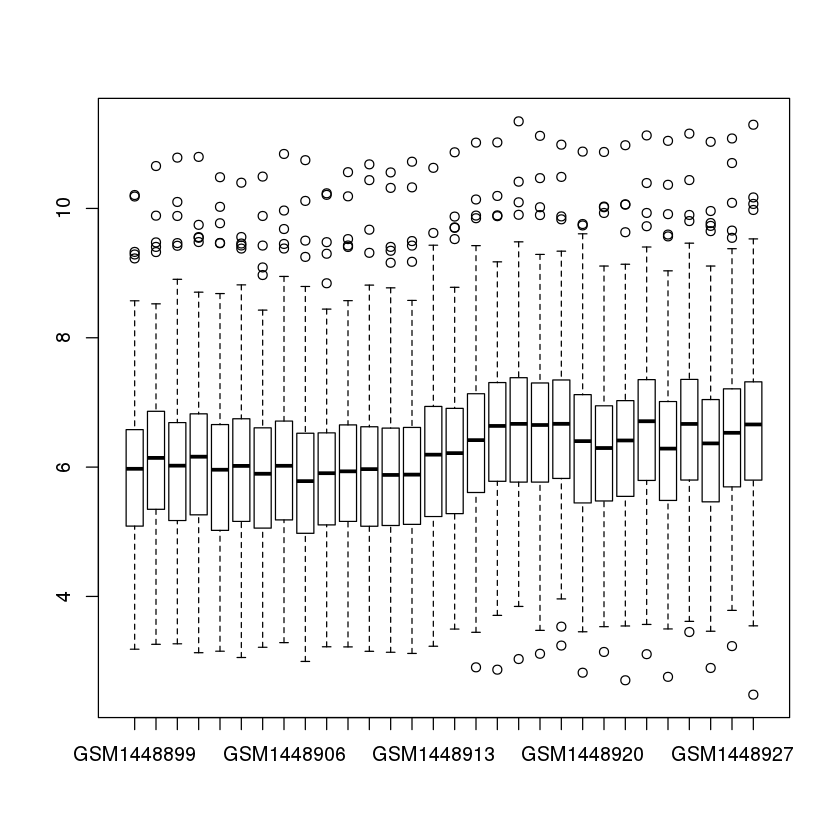

In [30]:
boxplot(genes_age)

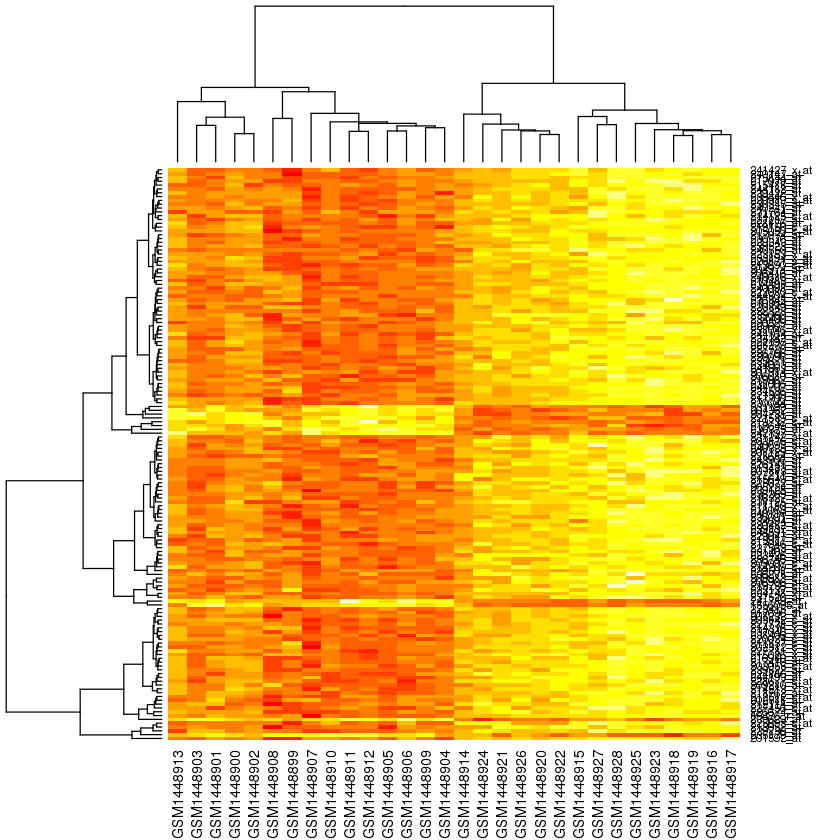

In [31]:
heatmap(genes_age)

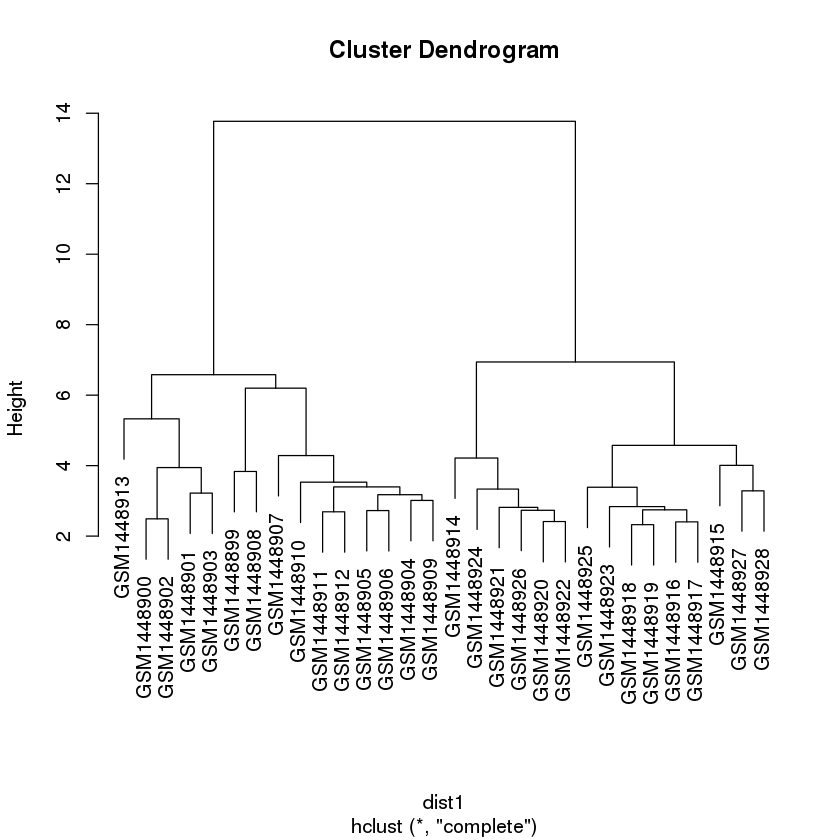

In [32]:
dist1 = dist(t(genes_age))

hclust1 = hclust(dist1)
plot(hclust1)

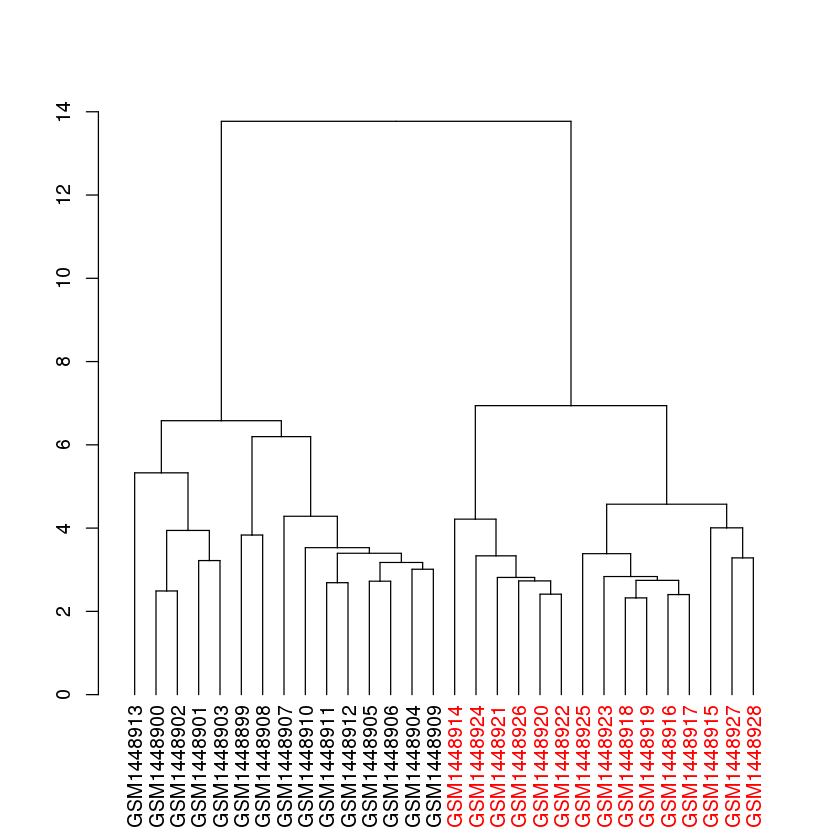

In [33]:
dend = as.dendrogram(hclust1)
dend = color_labels(hclust1,2,col=1:2)
plot(dend)

In [40]:
Sys.info()

sysname 
                                              "Linux" 
                                              release 
                                  "3.19.0-25-generic" 
                                              version 
"#26~14.04.1-Ubuntu SMP Fri Jul 24 21:16:20 UTC 2015" 
                                             nodename 
                                            "vagrant" 
                                              machine 
                                             "x86_64" 
                                                login 
                                            "vagrant" 
                                                 user 
                                            "vagrant" 
                                       effective_user 
                                            "vagrant"